###  STUDENT ID: 710026485

###                                     Social Networks and Text Analysis 

###                                               Coursework I

In [1]:
import numpy as np
import powerlaw
import pandas as pd
import networkx as nx
from pylab import rcParams
import seaborn as sns
import random 
import matplotlib.cm as cm
from itertools import count
import matplotlib.patches as patches
from matplotlib import colors as mcolors
import collections
from collections import Counter
import time
import matplotlib.pyplot as plt

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import warnings
warnings.filterwarnings('ignore')

In [2]:
pip install decorator

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install python-louvain

In [4]:
pip install python-igraph

Note: you may need to restart the kernel to use updated packages.


In [5]:
import community
import igraph
import community.community_louvain


#### Questions:

###### 1. Analyze a Network

###### (1.a) Load the Network.

Name: 
Type: Graph
Number of nodes: 410
Number of edges: 2765
Average degree:  13.4878


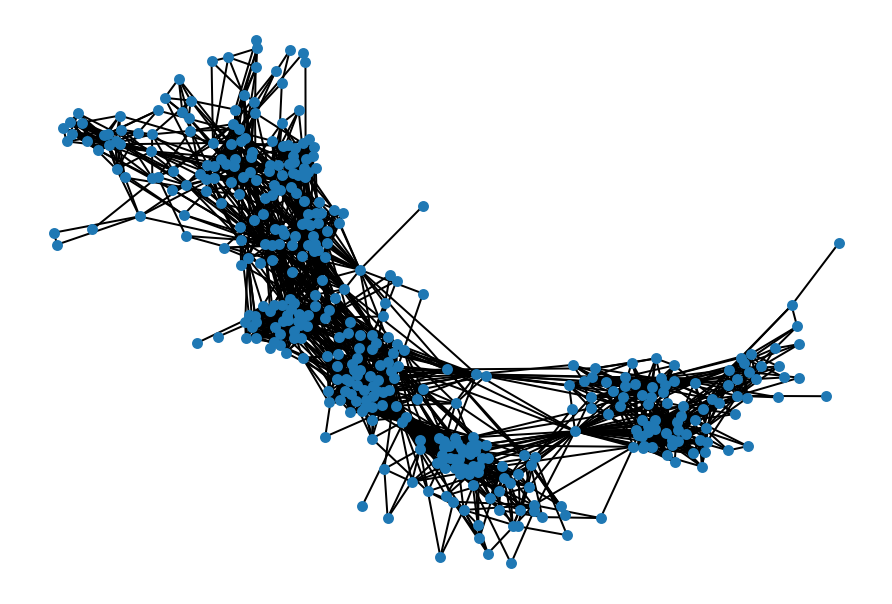

In [6]:
file=open("infect-dublin.edges", 'r')
Gx=nx.read_edgelist(file, nodetype=int,data=(('type',int),('id',int)) ,create_using=nx.Graph())
#Gx.adj
print(nx.info(Gx))

nx.draw_spring(Gx,node_size=20)

###### (1.b) Plot the Network Adjacency Matrix 

Text(0, 0.5, 'node idx')

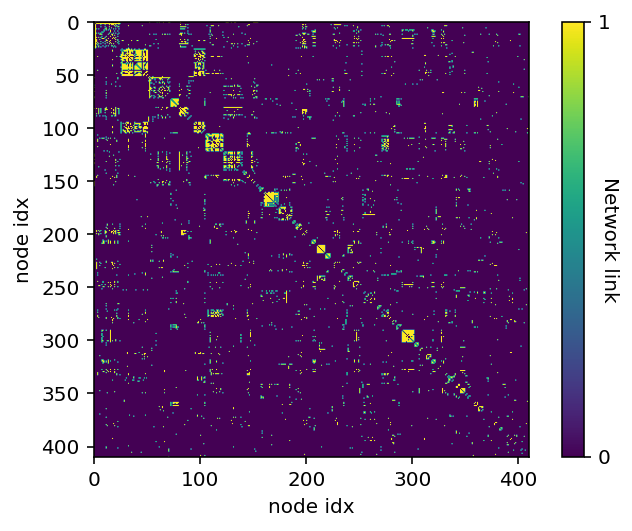

In [7]:
# print(nx.to_numpy_matrix(Gx)) 
plt.imshow(nx.to_numpy_matrix(Gx))
clrbar = plt.colorbar() 
clrbar.set_ticks([0,1])
clrbar.ax.set_yticklabels(['0','1'],) 

clrbar.set_label('Network link', rotation=270)
plt.xlabel('node idx') 
plt.ylabel('node idx') 

###### (1.c) Plot the Degree distribution. 

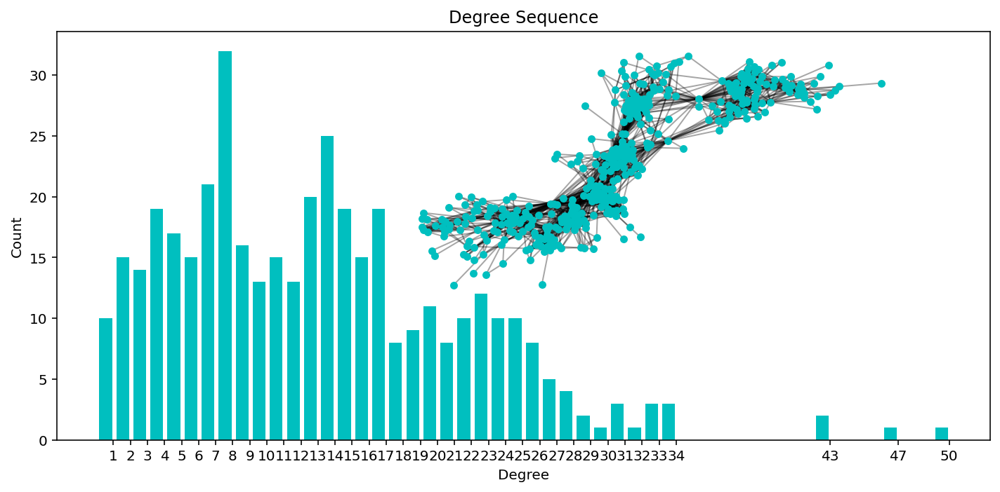

In [8]:
deg_sequence = sorted([deg for node, deg in Gx.degree()], reverse=True)  

degreeCnt = collections.Counter(deg_sequence) 

degree, count = zip(*degreeCnt.items())

rcParams['figure.figsize'] = 10, 5
fig, ax = plt.subplots()
plt.bar(degree, count, width=0.75, color='c') 

plt.title("Degree Sequence")
plt.xlabel("Degree")

plt.ylabel("Count")

ax.set_xticks([d + 0.45 for d in degree])
ax.set_xticklabels(degree)
plt.axes([0.4, 0.4, 0.5, 0.5])
plt.tight_layout()
Gcc = Gx.subgraph(sorted(nx.connected_components(Gx), key=len, reverse=True)[0])
pos = nx.spring_layout(Gx) 
plt.axis('off')
nx.draw_networkx_nodes(Gx, pos, node_color= 'c',node_size=20) 
nx.draw_networkx_edges(Gx, pos, alpha=0.35) 

plt.show()

###### (1.d) Plot the Degree sequence. 

Calculating best minimal value for power law fit


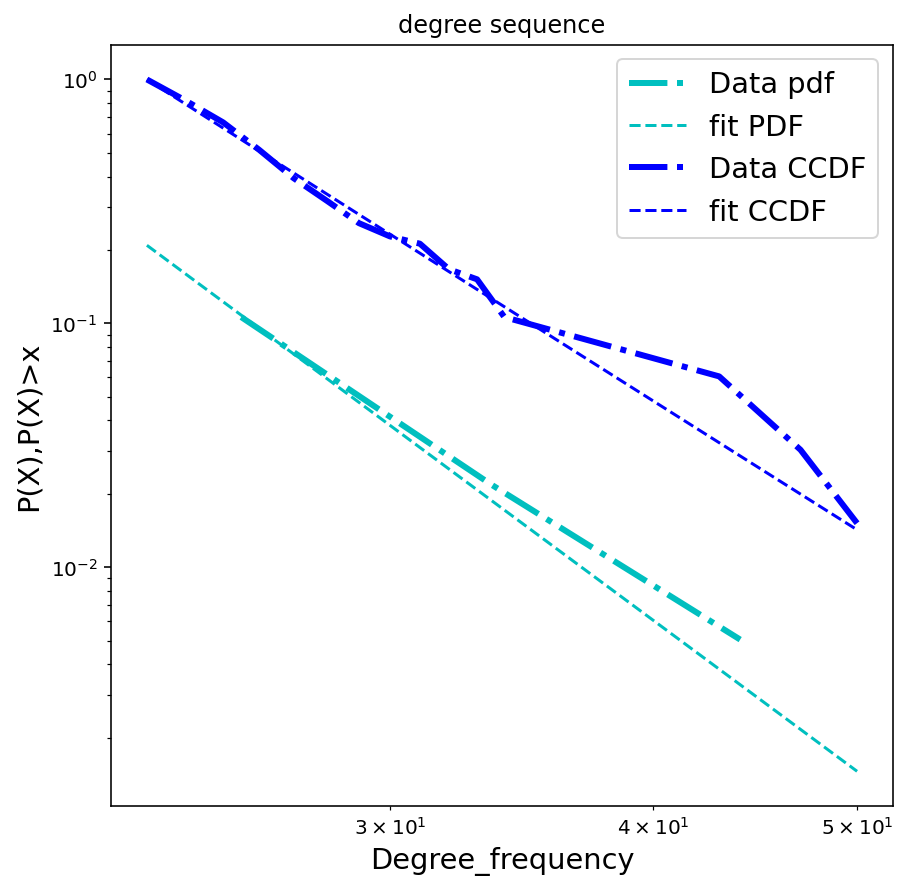

In [9]:
deg_sequence = sorted([deg for node, deg in Gx.degree()], reverse=True)  
degreeCnt = collections.Counter(deg_sequence)
plt.figure(figsize=(7,7))
fit = powerlaw.Fit(deg_sequence,discrete=True)
figure=fit.plot_pdf(color='c', linewidth=3,linestyle="-.")
fit.power_law.plot_pdf(color='c', linestyle='dashed', ax=figure)

fit.plot_ccdf(color='b', linewidth=3, ax=figure,linestyle="-.")
fit.power_law.plot_ccdf(color='b', linestyle='dashed', ax=figure)

plt.legend(['Data pdf', 'fit PDF', 'Data CCDF', 'fit CCDF'], fontsize = 'x-large')
plt.xlabel('Degree_frequency', fontsize = 'x-large')
plt.ylabel('P(X),P(X)>x', fontsize = 'x-large')
plt.title("degree sequence")
plt.show()


###### (1.e) Is the Network you are analyzing Assortative or Disassortative? 

In [10]:
deg_cof = nx.degree_assortativity_coefficient(Gx)
print(deg_cof)

0.2257519475783722


By calculating the degree Assortative coefficient, we can understand that the above network a positive coefficient. hence the network is an Assortative network

###### (2.a) Centralities.

Degree centrality:
Degree centrality is a simple count of the total number of connections linked to a vertex. It can be thought of as a kind of popularity measure, but a crude one that does not recognize a difference between quantity and quality. Degree centrality does not differentiate between a link to the president of the United States and a link to a high school dropout. Degree is the measure of the total number of edges connected to a particular vertex. For directed networks, there are two measures of degree. In-degree is the number of connections that point inward at a vertex. Out-degree is the number of connections that originate at a vertex and point outward to other vertices

Eigenvector centrality:
Eigenvector centrality measures a node’s importance while giving consideration to the importance of its neighbors. For example, a node with 100 relatively unpopular friends on Facebook would have lower eigenvector centrality than someone with 100 very popular friends . It is sometimes used to measure a node’s influence in the network.

difference:
A node receiving many links has high degree centrality but does not necessarily have a high eigenvector centrality. degree gives importance to links but Eigenvector measures a node’s importance while giving consideration to the importance of its neighbors.

Examples :
Degree centrality: Degree centrality can be seen in social media apps like instaram,twitter  where popular celebraties has many followers.
Eigenvector centrality: Eigenvector centrality can be seen in apps like banking,WhatsApp were the connections are given importance and known with each other   

###### (2.b.i) Closeness Centrality. 

In [11]:
import scipy.sparse,scipy.sparse.csgraph
import scipy
import numpy as np
def centrality_closeness(Gx):
    Adjacency=nx.to_numpy_matrix(Gx)

    
    shortest_dist=scipy.sparse.csgraph.dijkstra(Adjacency,directed=False,indices=None)
    shape=shortest_dist.shape[0]
    Clos_cent=np.zeros(shape)

    for r in range(shape):
        cnt=0
        for j in range(shape):
            cnt +=shortest_dist[r][j]
        if cnt==0:
            Clos_cent[r]=0

        else:
            Clos_cent[r]=(shape-1)/cnt

    n=Gx.nodes(data=False)
    n_list=list(n)    
    return Clos_cent

centrality_closeness(Gx)

array([0.3065967 , 0.36913357, 0.35814361, 0.3212883 , 0.30095659,
       0.32434576, 0.31680868, 0.30961393, 0.31389102, 0.2959479 ,
       0.31150038, 0.4013739 , 0.33998337, 0.31510015, 0.30095659,
       0.33829611, 0.32179386, 0.41565041, 0.30728775, 0.35658239,
       0.32408875, 0.33913765, 0.37488543, 0.31245225, 0.33745875,
       0.31150038, 0.33252033, 0.32078431, 0.27861035, 0.30636704,
       0.29297994, 0.2959479 , 0.34897611, 0.31293037, 0.27766463,
       0.31953125, 0.29068941, 0.27321309, 0.30984848, 0.28129298,
       0.3369028 , 0.32957293, 0.30318755, 0.30162242, 0.27956254,
       0.30051433, 0.28226363, 0.29941435, 0.34054954, 0.29530686,
       0.31102662, 0.250306  , 0.31754658, 0.30140015, 0.25482866,
       0.25      , 0.30613772, 0.26978892, 0.31461538, 0.25262508,
       0.31031866, 0.27014531, 0.26961107, 0.29637681, 0.31779332,
       0.2593532 , 0.3261563 , 0.29875822, 0.26925609, 0.3065967 ,
       0.25788146, 0.30914588, 0.28402778, 0.22546858, 0.28226

###### (2.b.ii) Closeness Centrality.

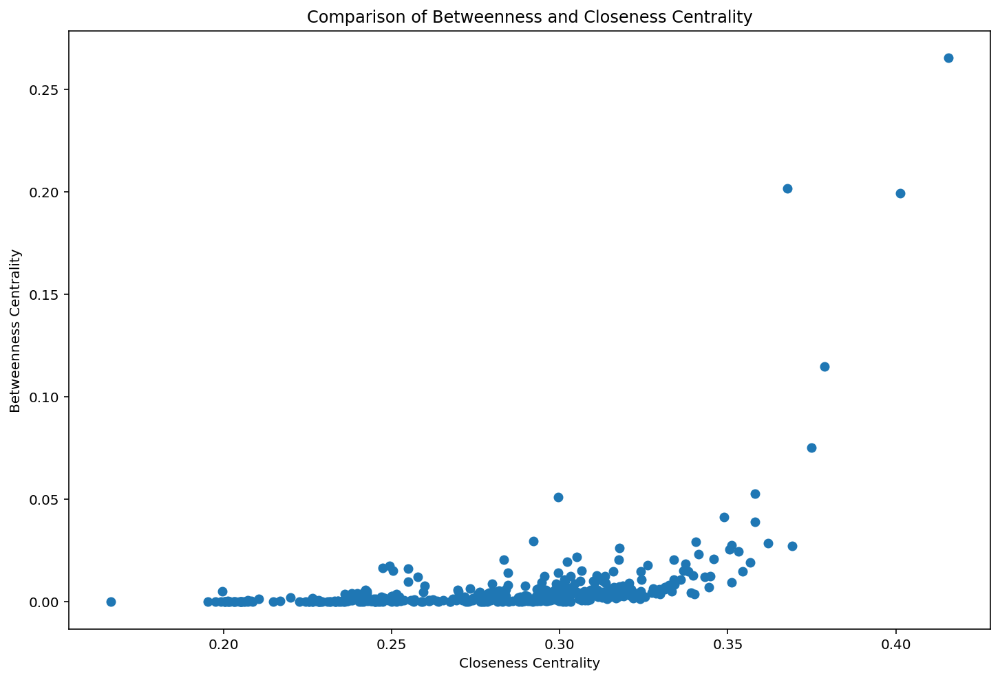

In [12]:
betweenness_centrality=nx.betweenness_centrality(Gx)
betweenness_centrality_lis=list(betweenness_centrality.values())
closeness_centrality_lis=list(centrality_closeness(Gx))
plt.figure(figsize=(12,8))
plt.scatter(closeness_centrality_lis, betweenness_centrality_lis)
plt.title('Comparison of Betweenness and Closeness Centrality')
plt.rc('font', size = 20)
plt.xlabel('Closeness Centrality')
plt.ylabel('Betweenness Centrality')
plt.show()

There is no or very low correlation between the centralities. It can be because Betweenness centrality measures others dependence on a given node, while Closeness Centrality is usually interpreted either as a measure of access efficiency or of independence from potential control by intermediaries

###### (2.c) Centrality Measure.

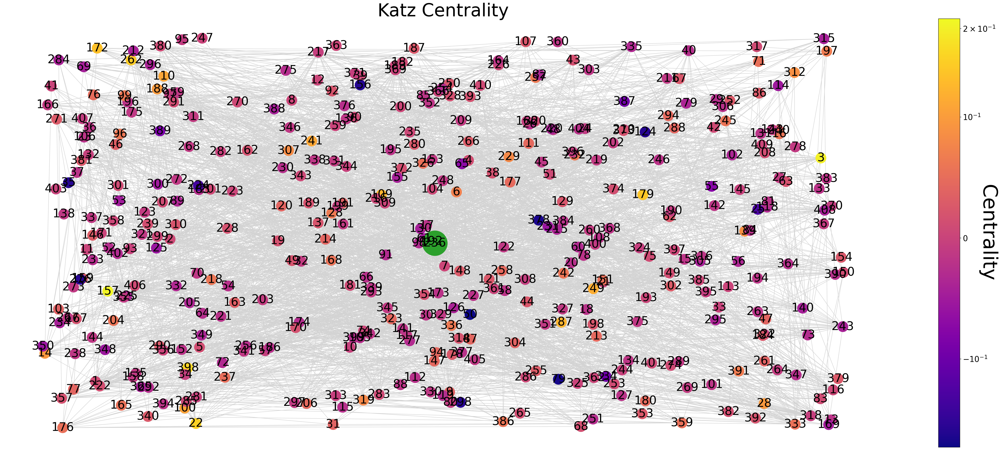

In [13]:
node_ids=Gx.nodes(data= False)      
pos=nx.random_layout(Gx)
k_Centrality=nx.katz_centrality_numpy(Gx)

k_keys= list(k_Centrality.keys()) 
k_val=list(k_Centrality.values())
k_val= np.array (k_val)
idx=np.argsort(k_val)[-1]
inf_node=k_keys[idx] 
plt.figure(figsize=(50, 20))
all_nodes = nx.draw_networkx_nodes(Gx, pos, node_size = 700 , 
                               cmap=plt.cm.plasma, node_color=list (k_Centrality.values ()), nodelist=list(k_Centrality.keys()))
all_nodes.set_norm( mcolors.SymLogNorm(linthresh=0.10, linscale=0.6))
lab_ntwk=nx.draw_networkx_labels (Gx, pos, font_size=30, font_color='black')
edges_ntwk =  nx.draw_networkx_edges (Gx, pos, edge_color="lightgrey" )
plt.title ('Katz Centrality', fontsize=45)
cbar =plt.colorbar (all_nodes)
nodes_ntwk=nx.draw_networkx_nodes(Gx, pos, node_size=4000, node_color="tab:green" , nodelist=[inf_node])
cbar.set_label('Centrality', fontsize=50, rotation=270)
plt.axis('off')
plt.show()

###### (2.d) Influencer Ego network

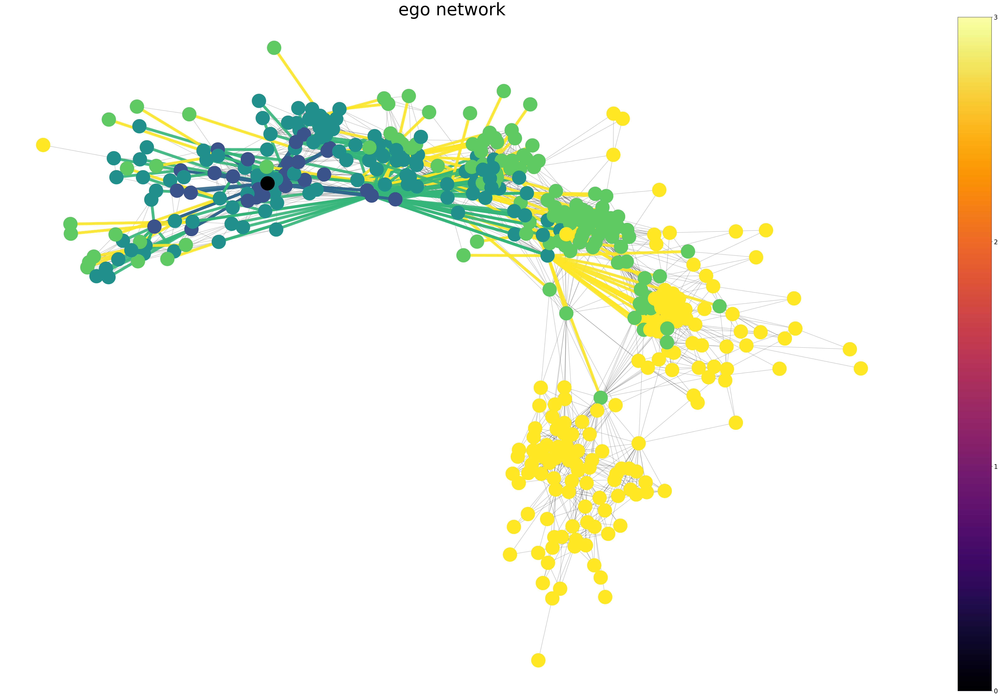

In [14]:
from itertools import count
def node_colors(Gx,inf_node,dist):
    
    nx.set_node_attributes(Gx, np.inf, "dist")
    shortest_path = nx.single_source_shortest_path_length(Gx, source = inf_node, cutoff = dist)
    for i, j in shortest_path.items():
        Gx.nodes[i]['dist'] = j
    
    sets = set(nx.get_node_attributes(Gx,'dist').values())
    normalize = mcolors.Normalize(vmin = 0, vmax = dist)
    scalarmap = cm.ScalarMappable(norm=normalize, cmap = cm.inferno)
    group = dict(zip(sorted(sets),count()))
    nodes = Gx.nodes()
    color = [group[Gx.nodes[i]['dist']] for i in nodes]
        
    return nodes,color
def edge_colors(Gx,inf_node,dist):
    
    shortest_path=nx.single_source_shortest_path(Gx, source = inf_node, cutoff = dist)
    sp_keys=list(shortest_path.keys())
    sp_vals=list(shortest_path.values())
    edges=[]
    colors=[]
    edges.append((inf_node,inf_node))
    colors.append(0)
    sp_keys.pop(0)
    sp_vals.pop(0)
    
    for i in range(len(sp_keys)):
        clr=1
        r=sp_vals[i]
        for j in range(len(r)-1):
            colors.append(clr)
            edges.append((r[j],r[j+1]))
            clr+=1
    
    return edges,colors




def Draw_ego_network(Gx,inf_node, dist): 
    
    
    pos=nx.spring_layout(Gx)
    plt.figure(figsize = (50,30))
    nx.draw(Gx,pos,node_color='lightgrey',node_size=700,alpha=0.3)
    
    nodes,node_color=node_colors(Gx,inf_node,dist)
    
    edges,edge_color=edge_colors(Gx,inf_node,dist)
    
    normalize = mcolors.Normalize(vmin = 0, vmax = dist)
    scalarmap = cm.ScalarMappable(norm=normalize, cmap = cm.inferno)
    nx.draw_networkx_nodes(Gx, pos, nodelist = nodes, node_color = node_color, node_size = 2000)
    nx.draw_networkx_edges(Gx,pos,edgelist=edges,edge_color=edge_color,width=9,alpha=0.9)
    nx.draw_networkx_nodes(Gx, pos, node_size=2000, node_color="black", nodelist=[inf_node])
    cbar = plt.colorbar(scalarmap, )
    cbar.set_ticks(range(0, dist+1))
    cbar.set_ticklabels(range(0, dist+1))
    plt.title("ego network",fontsize=55)
    plt.axis('off')
    plt.show()
        
    


Draw_ego_network(Gx,236,3)

###### (2.e) Community Detection 

In [15]:
pos = nx.spring_layout(Gx)
    
lbp=community.community_louvain.best_partition(Gx)
cnt = Counter(lbp.values())

cominf_node1=max(cnt, key=cnt.get)
del cnt[cominf_node1]

cominf_node2=max(cnt, key=cnt.get)

nodes_cominf_node1 = [key for key, val in lbp.items() if val == cominf_node1]
nodes_cominf_node2=[key for key, val in lbp.items() if val == cominf_node2]
nodes_com=[key for key,val in lbp.items() if (val!=cominf_node1 and val!=cominf_node2)]

for i in nodes_com:
    lbp[i]=-1
for i in nodes_cominf_node1:
    lbp[i]=0
for i in nodes_cominf_node2:
    lbp[i]=1
for i in nodes_com:
    lbp[i]=2
    

G_cominf_node1=Gx.subgraph(nodes_cominf_node1)
G_cominf_node2=Gx.subgraph(nodes_cominf_node2)
Cent=nx.closeness_centrality(G_cominf_node1)

key_cent=list(Cent.keys())
val_cent=list(Cent.values())
val_cent=np.array(val_cent)
indx=np.argsort(val_cent)[-1]
inf_node1=key_cent[indx]

Cent2=nx.katz_centrality_numpy(G_cominf_node2)

key_cent2=list(Cent2.keys())
val_cent2=list(Cent2.values())
val_cent2=np.array(val_cent2)
indx2=np.argsort(val_cent2)[-1]
inf_node2=key_cent2[indx2]
model='Louvain'
plt.figure(figsize = (100,80))
clus=np.array(list(set(lbp.values())))
nodes = nx.draw_networkx_nodes(Gx, pos, node_size=7000, cmap=mcolors.ListedColormap(plt.cm.Set3(clus)), 
                               node_color=list(lbp.values()),
                               nodelist=list(lbp.keys()),alpha=0.8)

nx.draw_networkx_nodes(Gx, pos, node_size=7000, node_color="lightblue", nodelist=[inf_node1],alpha=1.0)
nx.draw_networkx_nodes(Gx, pos, node_size=7000, node_color="red", nodelist=[inf_node2],alpha=1.0)
labels = nx.draw_networkx_labels(Gx, pos,font_size=30,alpha=0.9)
edges = nx.draw_networkx_edges(Gx, pos,alpha=0.5)
plt.title(model,fontsize=100)
cbar = plt.colorbar(nodes,ticks=range(0,len(clus)), label='Communities')
cbar.set_label('community detection', fontsize=100, rotation=270)
cbar.ax.tick_params(length=0)

cbar.set_ticklabels(list(set(lbp.values())))


nodes.set_clim(-0.5, len(clus)-0.5)

plt.axis('off')
plt.show()


Garages can be built on the nodes 302,157. By closeness centrality we can tell most nodes are relative to  these node ids. 

###### (2.f) Adjacency matrix of the Community Detection.

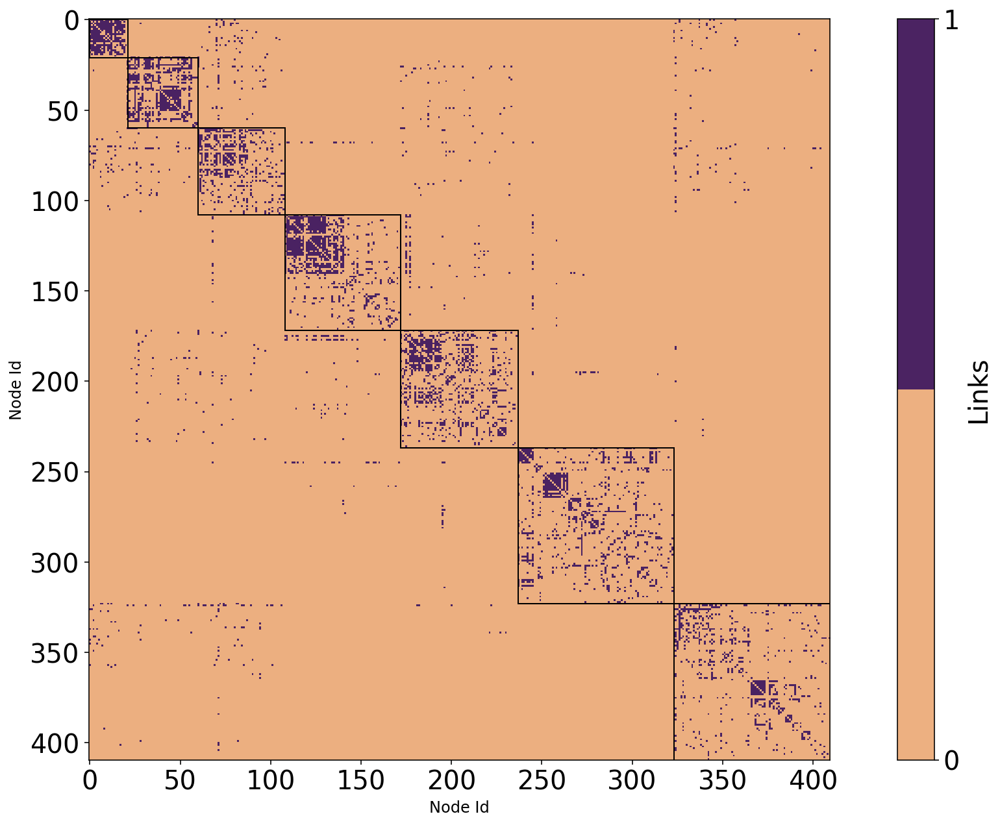

In [16]:
def plot_adj_comm(Gx,LBP):
    
    cnt = Counter(LBP.values())
    sorted_cnt = dict( sorted(cnt.items(),key=lambda item: item[1],reverse=False))
    comm=[]
    for key,val in sorted_cnt.items():
        comm.append(key)
    sorted_LBP={}

    for i in comm:
        for j in LBP.keys():
            if LBP[j]==i:
                sorted_LBP[j]=i
            else:
                continue
    edge=list(Gx.edges())
    node=[k for k in sorted_LBP.keys()]
    A=np.zeros((len(node),len(node)))

    
    for n in node:
        indx_n=node.index(n)
        for e in edge:
            if n==e[0]:
                indx=node.index(e[1])
                A[indx_n][indx]=1
                A[indx][indx_n]=1
            if n==e[1]:
                indx=node.index(e[0])
                A[indx_n][indx]=1
                A[indx][indx_n]=1
    
    rect_val=list(sorted_cnt.values())
    bnd=[(0,0)]
    sum=0
    for r in rect_val:
        sum+=r
        bnd.append((sum,sum))

    bnd.pop()
    fig, ax = plt.subplots()
    fig.set_size_inches(18.5, 10.5, forward=True)
    ax.imshow(A,interpolation='nearest',cmap=plt.cm.get_cmap('flare', 2)) 
    for i in range(len(rect_val)):
        rect=patches.Rectangle(bnd[i],rect_val[i],rect_val[i],linewidth=1, edgecolor='black',facecolor='none')
        ax.add_patch(rect)
    plt.xlabel('Node Id',fontsize=12)
    plt.ylabel('Node Id',fontsize=12)
    normalize = mcolors.Normalize(vmin = 0, vmax = 1)
    cb=fig.colorbar(cm.ScalarMappable(norm=normalize, cmap=plt.cm.get_cmap('flare', 2)), ax=ax,label='Links')
    cb.set_ticks([0,1])
    plt.show()
    
LBP=community.community_louvain.best_partition(Gx)
plot_adj_comm(Gx,LBP)


###### (3.a) SI Model.

In [17]:
def SI_model(A,initial_infected,beta,t_simulation):
       
    A_list=list(A.nodes)
    n=len(A_list)
    
    states = np.zeros([n+1, t_simulation+1]) 
    Infected = np.zeros(n+1,)
    
    if initial_infected is None:
        initial_infected = np.random.choice(range(n), 3)
        states[initial_infected,0] = 1
    else:
        states[initial_infected,0] = 1
                
    Infected[initial_infected] = 1
    mylis=[]
    reco=np.array(mylis)
    
    # Start simulation
    for t in range(1, t_simulation+1):
        
        states[Infected>0, t] = 1
        states[Infected==0, t] = 0
        curInf = np.nonzero(states[:,t])[0]
        states[curInf, t] = 1
        for i in curInf:
            NN=list(nx.all_neighbors(A,i))
            infNN = [n for n in NN if np.random.uniform(0,1)<beta]
            for i in infNN:
                states[i, t] = 1
                Infected[i] =  1
               
    status=np.where(states>0,"I","S")
    final={}
   
    for i in range(0, t_simulation+1):
        final[i]=status[:,i]
    return final
Gx = nx.read_edgelist('infect-dublin.edges', nodetype=int, create_using=nx.Graph(),data=(('weight',float),))



--- 10.610831022262573 seconds ---


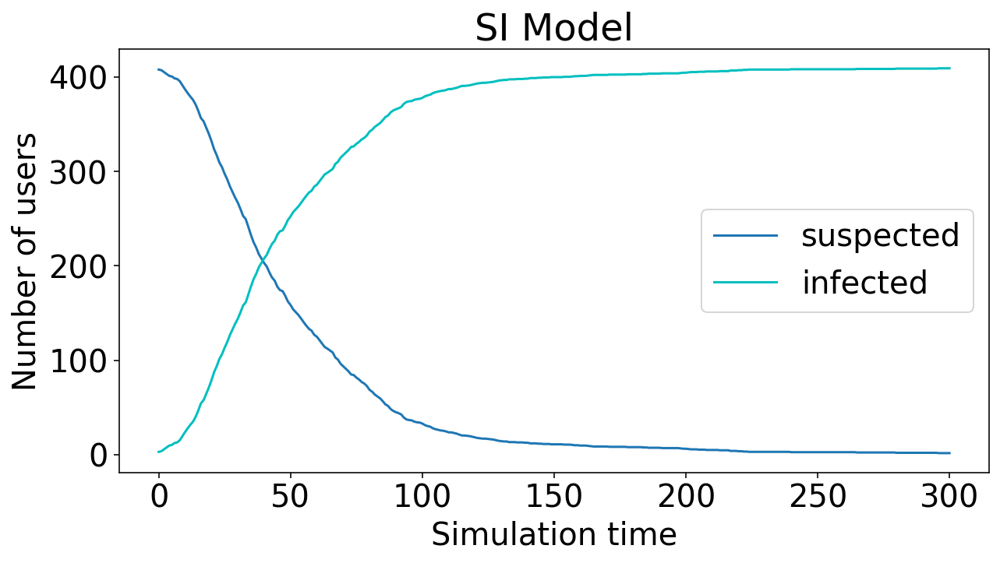

In [18]:
avg_suspect=np.zeros(300+1,)
avg_infected=np.zeros(300+1,)

for i in range(3):
    
    start = time.time()

    SI=SI_model(Gx,[1,3,5],0.01,300) 
    infectedlist_SI=[]
    suspectedlist_SI=[]
    for i in (SI.keys()):
        b=np.count_nonzero(SI[i] == "S")
        c=np.count_nonzero(SI[i] == "I")
        
        infectedlist_SI.append(c)
        suspectedlist_SI.append(b)
        
    avg_suspect=np.add(avg_suspect,suspectedlist_SI)
    avg_infected=np.add(avg_infected,infectedlist_SI)
    
    
    
infectedlist_SI=avg_infected/3
suspectedlist_SI=avg_suspect/3 


print("--- %s seconds ---" % (time.time() - start))
plt.plot(range(len(suspectedlist_SI)),suspectedlist_SI,label="suspected")
plt.plot(range(len(suspectedlist_SI)),infectedlist_SI,"c",label="infected")
plt.legend()
plt.xlabel("Simulation time")
plt.ylabel("Number of users") 
plt.title("SI Model")
plt.show()   

###### (3.b) SIR Model

In [19]:
def SIR_model(A,initial_infected,beta,t_simulation,recovery_time):
    
    A_list=list(A.nodes)
    n=len(A_list)
    states = np.zeros([n+1, t_simulation+1]) 
    recovery = np.zeros(n+1,)
    
    if initial_infected is None:
        initial_infected = np.random.choice(range(n), 3)
        states[initial_infected,0] = 1
    else:
        states[initial_infected,0] = 1
    
    recovery[initial_infected] = recovery_time + 1
    mylis=[]
    reco=np.array(mylis)
    # Start simulation
    for t in range(1, t_simulation+1):
        
        if 1 in recovery:
            a=np.where(recovery==1)
            reco=np.append(reco,a)
            
        recovery = np.maximum(recovery-1,0)
        states[recovery>0, t] = 1
        states[recovery==0, t] = 0
        
        for i in reco:
            states[int(i), t] = -1
        curInf=np.where(states[:,t]>0) 
        l=np.array(curInf).tolist()
        l=sum(l, [])
        states[curInf, t] = 1
        for i in l:
            
            NN=list(nx.all_neighbors(A,i))
            infNN = [n for n in NN if np.random.uniform(0,1)<beta]
            for i in infNN:
                if recovery[i]==0 and i not in reco:
                    
                    states[i, t] = 1
                    recovery[i] = recovery_time + 1
                elif i in reco:
                    states[i, t] = -1
                
            
                
           
    status=np.where(states<0,'R',(np.where(states>0,'I','S')))
    
    final={}
   
    for i in range(0, t_simulation+1):
        final[i]=status[:,i]
    
    return final
SIR=SIR_model(Gx,[1,3,5],0.005,300,15)    

--- 0.39766550064086914 seconds ---


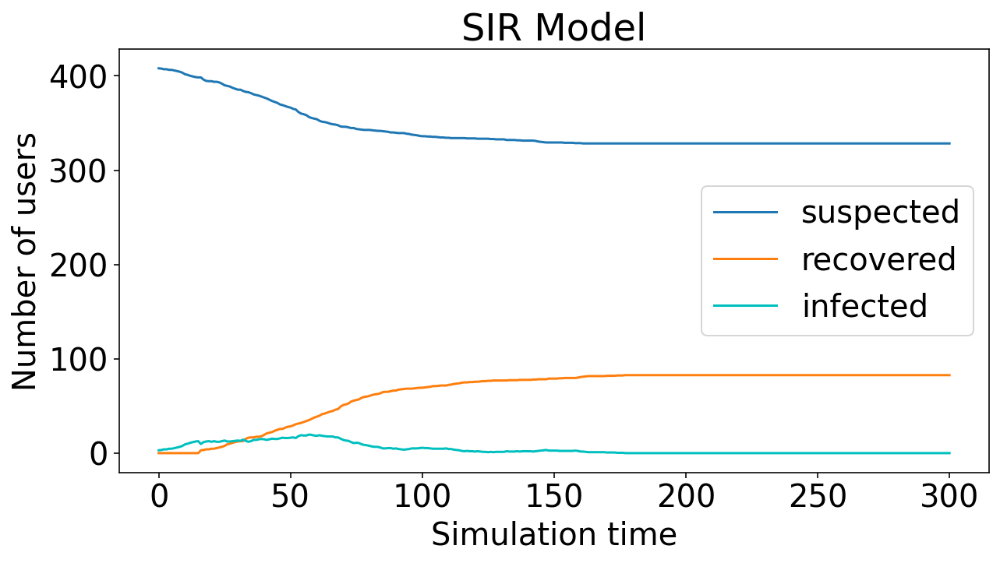

In [20]:
avg_suspect=np.zeros(300+1,)
avg_infected=np.zeros(300+1,)
avg_recovered=np.zeros(300+1,)

for i in range(3):
    
    start = time.time()

    SIR=SIR_model(Gx,[1,3,5],0.005,300,15) 
    recoverdlist_SIR=[]
    infectedlist_SIR=[]
    suspectedlist_SIR=[]
    for i in (SIR.keys()):
        a=np. count_nonzero(SIR[i] == "R")
        b=np. count_nonzero(SIR[i] == "S")
        c=np. count_nonzero(SIR[i] == "I")
        recoverdlist_SIR.append(a)
        infectedlist_SIR.append(c)
        suspectedlist_SIR.append(b)
    avg_suspect=np.add(avg_suspect,suspectedlist_SIR)
    avg_infected=np.add(avg_infected,infectedlist_SIR)
    avg_recovered=np.add(avg_recovered,recoverdlist_SIR)
    
    
infectedlist_SIR=avg_infected/3
suspectedlist_SIR=avg_suspect/3 
recoverdlist_SIR=avg_recovered/3

print("--- %s seconds ---" % (time.time() - start))
plt.plot(range(len(suspectedlist_SIR)),suspectedlist_SIR,label="suspected")
plt.plot(range(len(suspectedlist_SIR)),recoverdlist_SIR,label="recovered")
plt.plot(range(len(suspectedlist_SIR)),infectedlist_SIR,"c",label="infected")
plt.legend()
plt.xlabel("Simulation time")
plt.ylabel("Number of users") 
plt.title("SIR Model")
plt.show()   

###### (3.c) Second Wave

In [21]:
def SISW_model(A,initial_infected,beta,t_simulation,recovery_time):
    
    
    A_list=list(A.nodes)
    n=len(A_list)
    
    states = np.zeros([n+1, t_simulation+1])
    recovery = np.zeros(n+1,)
    
    
    if initial_infected is None:
        initial_infected = np.random.choice(range(n), 3)
        states[initial_infected,0] = 1
    else:
        states[initial_infected,0] = 1
        
    recovery[initial_infected] = recovery_time + 1
    mylis=[]
    reco=np.array(mylis)
    sw=np.array(mylis)
    # Start simulation
    for t in range(1, t_simulation+1):
        if t==101:
            
            lis2= [x for x in A_list if x not in reco]
            Second_infected = np.random.choice(lis2, 30)
            recovery[Second_infected] = recovery_time + 1
            sw=np.append(sw,Second_infected)
        if 1 in recovery:
            a=np.where(recovery==1)
            reco=np.append(reco,a)
            
            
        recovery = np.maximum(recovery-1,0)
        
        states[recovery>0, t] = 1
        states[recovery==0, t] = 0       
        for i in reco:
            
            states[int(i), t] = -1
        for i in sw:
            states[int(i), t] = 2
        
        firstInf=np.where(states[:,t]==1) 
        I1=np.array(firstInf).tolist()
        I1=sum(I1, [])
        SecondInf=np.where(states[:,t]==2) 
        I2=np.array(SecondInf).tolist()
        
        I2=sum(I2, [])
        
        for i in I1:
            
            
            NN=list(nx.all_neighbors(A,i))
            
            infNN = [n for n in NN if np.random.uniform(0,1)<beta]
            for i in infNN:
                if recovery[i]==0 and i not in reco and i not in sw:
                    
                    states[i, t] = 1
                    recovery[i] = recovery_time + 1
                elif i in reco:
                    states[i, t] = -1
        
        for i in I2:
            NN=list(nx.all_neighbors(A,i))
            
            infNN = [n for n in NN if np.random.uniform(0,1)<0.02]
            for i in infNN:
                if recovery[i]==0 and i not in reco:
                    
                    states[i, t] = 2
                    recovery[i] = recovery_time + 1
                    sw=np.append(sw,i)
                elif i in reco:
                    states[i, t] = -1
                    
                
            
                
           
    status=np.where(states<0,'R',(np.where(states==0,'S',np.where(states>1,'SW','I'))))
    status[states<0]='R'
    status[states==1]='I'
    status[states==0]='S'
    status[states==2]="SW"
    final={}
   
    for i in range(0, t_simulation+1):
        final[i]=status[:,i]
    return final
SISW=SISW_model(Gx,[1,3,5],0.01,300,15)    

--- 2.0883822441101074 seconds ---


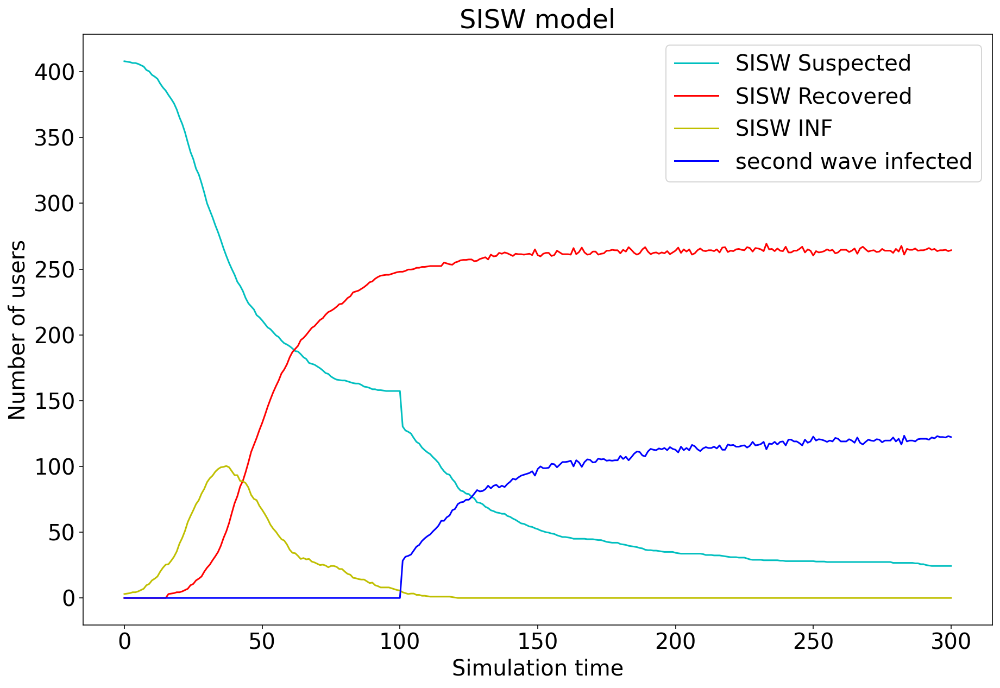

In [22]:
avg_suspect=np.zeros(300+1,)
avg_infected=np.zeros(300+1,)
avg_recovered=np.zeros(300+1,)
avg_second=np.zeros(300+1,)
for i in range(3):
    #print(i)
    start = time.time()

    SISW=SISW_model(Gx,[1,3,5],0.01,300,15) 
    recoverdlist_SISW=[]
    infectedlist_SISW=[]
    suspectedlist_SISW=[]
    Secondwaveinfection=[]
    for i in (SISW.keys()):
        a=np.count_nonzero(SISW[i] == "R")
        b=np.count_nonzero(SISW[i] == "S")
        c=np.count_nonzero(SISW[i] == "I")
        d=np.count_nonzero(SISW[i] == "SW")
        recoverdlist_SISW.append(a)
        infectedlist_SISW.append(c)
        suspectedlist_SISW.append(b)
        Secondwaveinfection.append(d)
    avg_suspect=np.add(avg_suspect,suspectedlist_SISW)
    avg_infected=np.add(avg_infected,infectedlist_SISW)
    avg_recovered=np.add(avg_recovered,recoverdlist_SISW)
    avg_second=np.add(avg_second,Secondwaveinfection)
    
infectedlist_SISW=avg_infected/3
suspectedlist_SISW=avg_suspect/3 
recoverdlist_SISW=avg_recovered/3
Secondwaveinfection=avg_second/3
print("--- %s seconds ---" % (time.time() - start))
plt.figure(figsize=(15,10))
plt.plot(range(len(suspectedlist_SISW)),suspectedlist_SISW,"c",label="SISW Suspected")
plt.plot(range(len(suspectedlist_SISW)),recoverdlist_SISW,"r",label="SISW Recovered")
plt.plot(range(len(suspectedlist_SISW)),infectedlist_SISW,"y",label="SISW INF")
plt.plot(range(len(suspectedlist_SISW)),Secondwaveinfection,"b",label="second wave infected")
plt.xlabel("Simulation time")
plt.ylabel("Number of users") 
plt.title("SISW model")
plt.legend()
plt.show()


###### (3.d) Remarks

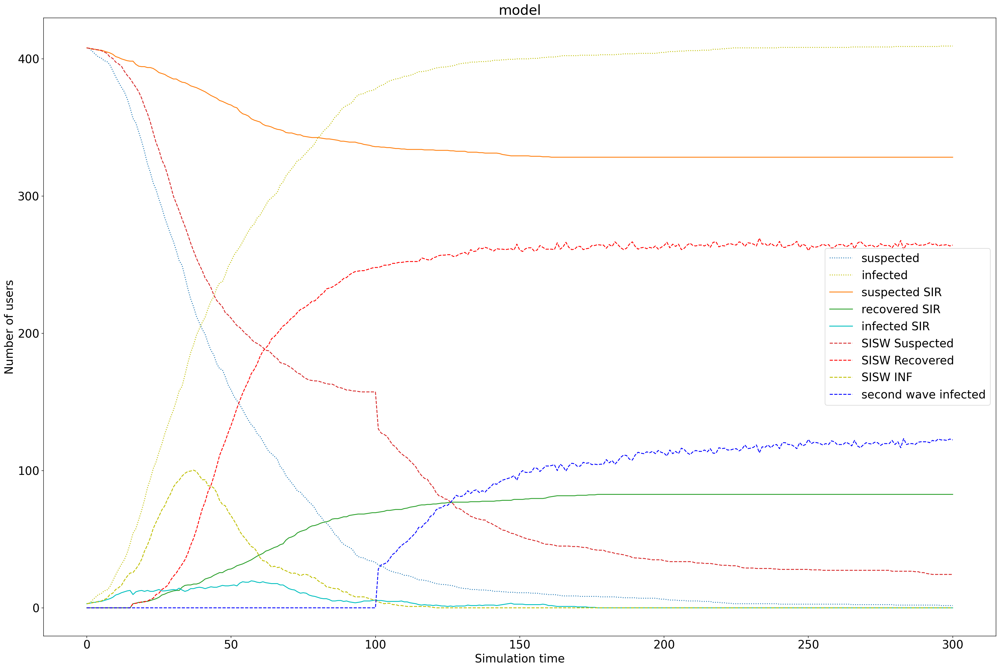

In [23]:
plt.figure(figsize=(30,20))
plt.plot(range(len(suspectedlist_SI)),suspectedlist_SI,label="suspected",linestyle=":")
plt.plot(range(len(suspectedlist_SI)),infectedlist_SI,"y",label="infected",linestyle=":")
plt.plot(range(len(suspectedlist_SIR)),suspectedlist_SIR,label="suspected SIR")
plt.plot(range(len(suspectedlist_SIR)),recoverdlist_SIR,label="recovered SIR")
plt.plot(range(len(suspectedlist_SIR)),infectedlist_SIR,"c",label="infected SIR")
plt.plot(range(len(suspectedlist_SISW)),suspectedlist_SISW,label="SISW Suspected",linestyle="--")
plt.plot(range(len(suspectedlist_SISW)),recoverdlist_SISW,"r",label="SISW Recovered",linestyle="--")
plt.plot(range(len(suspectedlist_SISW)),infectedlist_SISW,"y",label="SISW INF",linestyle="--")
plt.plot(range(len(suspectedlist_SISW)),Secondwaveinfection,"b",label="second wave infected",linestyle="--")

plt.xlabel("Simulation time")
plt.ylabel("Number of users") 
plt.title("model")

plt.legend()
plt.show()

1.In SI Model the total number of suspected and infected is always constant.  We can observe tat after certain time all the suspected are converted to infected.
2. In SIR model S+I+R is always constant. WE can observe that there is initial raise in infection but as the infections are recovered and immune, we see a drop in infection rate.                                                                         
3. In second wave model we observe that S+I+R is always constant. There is a raise in initial infection and a drop of infection rate as recovery rate increased. After introducing the second wave we can see there is a increase in infection rate and decrease in suspectable rate. 
